In [10]:
from transformers import MarianConfig

In [11]:
import torch.nn.init as init
import torch
from torch import nn
import transformers.models.marian.modeling_marian as marian

MarianDecoder = marian.MarianDecoder
BaseModelOutputWithPastAndCrossAttentions = marian.BaseModelOutputWithPastAndCrossAttentions
_prepare_4d_causal_attention_mask = marian._prepare_4d_causal_attention_mask
_prepare_4d_attention_mask = marian._prepare_4d_attention_mask
logger = marian.logger

Optional = marian.Optional
Union = marian.Union
Tuple = marian.Tuple
BaseModelOutput = marian.BaseModelOutput
Seq2SeqModelOutput = marian.Seq2SeqModelOutput
MarianPreTrainedModel = marian.MarianPreTrainedModel
MarianEncoder = marian.MarianEncoder
copy = marian.copy

class CustomMarianDecoder(MarianDecoder):
    def __init__(self, config: MarianConfig, embed_tokens):
        super().__init__(config, embed_tokens)

        # 添加 encoder_layers 个全连接层
        self.additional_linear_layers = nn.ModuleList([
            nn.Linear(config.hidden_size * config.encoder_layers, config.hidden_size, bias=False)
            for _ in range(config.encoder_layers)
        ])

    def forward(
        self,
        input_ids: torch.LongTensor = None,
        attention_mask: Optional[torch.Tensor] = None,
        encoder_hidden_states: Optional[torch.FloatTensor] = None,
        encoder_attention_mask: Optional[torch.LongTensor] = None,
        head_mask: Optional[torch.Tensor] = None,
        cross_attn_head_mask: Optional[torch.Tensor] = None,
        past_key_values: Optional[Tuple[Tuple[torch.FloatTensor]]] = None,
        inputs_embeds: Optional[torch.FloatTensor] = None,
        use_cache: Optional[bool] = None,
        output_attentions: Optional[bool] = None,
        output_hidden_states: Optional[bool] = None,
        return_dict: Optional[bool] = None,
    ) -> Union[Tuple[torch.Tensor], BaseModelOutputWithPastAndCrossAttentions]:

        output_attentions = output_attentions if output_attentions is not None else self.config.output_attentions
        output_hidden_states = (
            output_hidden_states if output_hidden_states is not None else self.config.output_hidden_states
        )
        use_cache = use_cache if use_cache is not None else self.config.use_cache
        return_dict = return_dict if return_dict is not None else self.config.use_return_dict

        # retrieve input_ids and inputs_embeds
        if input_ids is not None and inputs_embeds is not None:
            raise ValueError("You cannot specify both decoder_input_ids and decoder_inputs_embeds at the same time")
        elif input_ids is not None:
            input_shape = input_ids.size()
            input_ids = input_ids.view(-1, input_shape[-1])
        elif inputs_embeds is not None:
            input_shape = inputs_embeds.size()[:-1]
        else:
            raise ValueError("You have to specify either decoder_input_ids or decoder_inputs_embeds")

        # past_key_values_length
        past_key_values_length = past_key_values[0][0].shape[2] if past_key_values is not None else 0

        if inputs_embeds is None:
            inputs_embeds = self.embed_tokens(input_ids) * self.embed_scale

        attention_mask = _prepare_4d_causal_attention_mask(
            attention_mask, input_shape, inputs_embeds, past_key_values_length
        )

        # expand encoder attention mask
        if encoder_hidden_states is not None and encoder_attention_mask is not None:
            # [bsz, seq_len] -> [bsz, 1, tgt_seq_len, src_seq_len]
            encoder_attention_mask = _prepare_4d_attention_mask(
                encoder_attention_mask, inputs_embeds.dtype, tgt_len=input_shape[-1]
            )

        # embed positions
        positions = self.embed_positions(input_shape, past_key_values_length)

        hidden_states = inputs_embeds + positions

        hidden_states = nn.functional.dropout(hidden_states, p=self.dropout, training=self.training)

        if self.gradient_checkpointing and self.training:
            if use_cache:
                logger.warning_once(
                    "`use_cache=True` is incompatible with gradient checkpointing. Setting `use_cache=False`..."
                )
                use_cache = False

        # decoder layers
        all_hidden_states = () if output_hidden_states else None
        all_self_attns = () if output_attentions else None
        all_cross_attentions = () if (output_attentions and encoder_hidden_states is not None) else None
        next_decoder_cache = () if use_cache else None

        # check if head_mask/cross_attn_head_mask has a correct number of layers specified if desired
        for attn_mask, mask_name in zip([head_mask, cross_attn_head_mask], ["head_mask", "cross_attn_head_mask"]):
            if attn_mask is not None:
                assert attn_mask.size()[0] == (len(self.layers)), (
                    f"The `{mask_name}` should be specified for {len(self.layers)} layers, but it is for"
                    f" {head_mask.size()[0]}."
                )

        # 合并 encoder_hidden_states
        # encoder_hidden_states[5] 是 lash_hidden_state
        encoder_hidden_states_all = torch.cat(encoder_hidden_states, dim=-1)
        # print((encoder_hidden_states_all[:, :, :512] == encoder_hidden_states[5]).all())
        # print((encoder_hidden_states_all[:, :, -512:] == encoder_hidden_states[5]).all())
        # print((encoder_hidden_states[5] == torch.matmul(encoder_hidden_states_all, self.additional_linear_layers[0].weight.t())).all())
        # print(encoder_hidden_states[5])
        # print(self.additional_linear_layers[0].weight.t())
        # print(torch.matmul(encoder_hidden_states_all, self.additional_linear_layers[0].weight.t()))
        

        for idx, decoder_layer in enumerate(self.layers):

            # 调用对应的 linear_layer
            linear_layer = self.additional_linear_layers[idx]
            # 加权处理
            encoder_hidden_states = linear_layer(encoder_hidden_states_all)
            
            # print(idx)
            # print(encoder_hidden_states.shape)

            # add LayerDrop (see https://arxiv.org/abs/1909.11556 for description)
            if output_hidden_states:
                all_hidden_states += (hidden_states,)
            if self.training:
                dropout_probability = torch.rand([])
                if dropout_probability < self.layerdrop:
                    continue

            past_key_value = past_key_values[idx] if past_key_values is not None else None

            if self.gradient_checkpointing and self.training:
                layer_outputs = self._gradient_checkpointing_func(
                    decoder_layer.__call__,
                    hidden_states,
                    attention_mask,
                    encoder_hidden_states,
                    encoder_attention_mask,
                    head_mask[idx] if head_mask is not None else None,
                    cross_attn_head_mask[idx] if cross_attn_head_mask is not None else None,
                    None,
                    output_attentions,
                    use_cache,
                )
            else:
                layer_outputs = decoder_layer(
                    hidden_states,
                    attention_mask=attention_mask,
                    encoder_hidden_states=encoder_hidden_states,
                    encoder_attention_mask=encoder_attention_mask,
                    layer_head_mask=(head_mask[idx] if head_mask is not None else None),
                    cross_attn_layer_head_mask=(
                        cross_attn_head_mask[idx] if cross_attn_head_mask is not None else None
                    ),
                    past_key_value=past_key_value,
                    output_attentions=output_attentions,
                    use_cache=use_cache,
                )

            hidden_states = layer_outputs[0]

            if use_cache:
                next_decoder_cache += (layer_outputs[3 if output_attentions else 1],)

            if output_attentions:
                all_self_attns += (layer_outputs[1],)

                if encoder_hidden_states is not None:
                    all_cross_attentions += (layer_outputs[2],)

        # add hidden states from the last decoder layer
        if output_hidden_states:
            all_hidden_states += (hidden_states,)

        next_cache = next_decoder_cache if use_cache else None
        if not return_dict:
            return tuple(
                v
                for v in [hidden_states, next_cache, all_hidden_states, all_self_attns, all_cross_attentions]
                if v is not None
            )
        return BaseModelOutputWithPastAndCrossAttentions(
            last_hidden_state=hidden_states,
            past_key_values=next_cache,
            hidden_states=all_hidden_states,
            attentions=all_self_attns,
            cross_attentions=all_cross_attentions,
        )

In [12]:
class CustomSeq2SeqModel(MarianPreTrainedModel):
    def __init__(self, config: MarianConfig):
        super().__init__(config)

        padding_idx, vocab_size = config.pad_token_id, config.vocab_size

        # We always use self.shared for token embeddings to ensure compatibility with all marian models
        self.shared = nn.Embedding(vocab_size, config.d_model, padding_idx)
        if self.config.share_encoder_decoder_embeddings:
            encoder_embed_tokens = decoder_embed_tokens = self.shared
        else:
            # Since the embeddings are not shared, deepcopy the embeddings here for encoder
            # and decoder to make sure they are not tied.
            encoder_embed_tokens = copy.deepcopy(self.shared)
            decoder_embed_tokens = copy.deepcopy(self.shared)
            self.shared = None

        self.encoder = MarianEncoder(config, encoder_embed_tokens)
        # self.decoder = MarianDecoder(config, decoder_embed_tokens)
        self.decoder = CustomMarianDecoder(config, decoder_embed_tokens)

        # Initialize weights and apply final processing
        self.post_init()

    def get_input_embeddings(self):
        # This will return shared embeddings if they are shared else specific to encoder.
        return self.get_encoder().get_input_embeddings()

    def set_input_embeddings(self, value):
        if self.config.share_encoder_decoder_embeddings:
            self.shared = value
            self.encoder.embed_tokens = self.shared
            self.decoder.embed_tokens = self.shared
        else:  # if not shared only set encoder embeedings
            self.encoder.embed_tokens = value

    def get_decoder_input_embeddings(self):
        if self.config.share_encoder_decoder_embeddings:
            raise ValueError(
                "`get_decoder_input_embeddings` should not be called if `config.share_encoder_decoder_embeddings` "
                "is `True`. Please use `get_input_embeddings` instead."
            )
        return self.get_decoder().get_input_embeddings()

    def set_decoder_input_embeddings(self, value):
        if self.config.share_encoder_decoder_embeddings:
            raise ValueError(
                "`config.share_encoder_decoder_embeddings` is set to `True` meaning the decoder input embeddings "
                "are shared with the encoder. In order to set the decoder input embeddings, you should simply set "
                "the encoder input embeddings by calling `set_input_embeddings` with the appropriate embeddings."
            )
        self.decoder.embed_tokens = value

    def get_encoder(self):
        return self.encoder

    def get_decoder(self):
        return self.decoder

    def resize_decoder_token_embeddings(self, new_num_tokens: int) -> nn.Embedding:
        if self.config.share_encoder_decoder_embeddings:
            raise ValueError(
                "`resize_decoder_token_embeddings` should not be called if `config.share_encoder_decoder_embeddings` "
                "is `True`. Please use `resize_token_embeddings` instead."
            )

        old_embeddings = self.get_decoder_input_embeddings()
        new_embeddings = self._get_resized_embeddings(old_embeddings, new_num_tokens)
        self.set_decoder_input_embeddings(new_embeddings)

        model_embeds = self.get_decoder_input_embeddings()

        if new_num_tokens is None:
            return model_embeds

        # Update base model and current model config
        self.config.decoder_vocab_size = new_num_tokens

        # Tie weights again if needed
        self.tie_weights()

        return model_embeds

    def forward(
        self,
        input_ids: torch.LongTensor = None,
        attention_mask: Optional[torch.Tensor] = None,
        decoder_input_ids: Optional[torch.LongTensor] = None,
        decoder_attention_mask: Optional[torch.Tensor] = None,
        head_mask: Optional[torch.Tensor] = None,
        decoder_head_mask: Optional[torch.Tensor] = None,
        cross_attn_head_mask: Optional[torch.Tensor] = None,
        encoder_outputs: Optional[Union[Tuple[torch.Tensor], BaseModelOutput]] = None,
        past_key_values: Optional[Tuple[Tuple[torch.FloatTensor]]] = None,
        inputs_embeds: Optional[torch.FloatTensor] = None,
        decoder_inputs_embeds: Optional[torch.FloatTensor] = None,
        use_cache: Optional[bool] = None,
        output_attentions: Optional[bool] = None,
        output_hidden_states: Optional[bool] = None,
        return_dict: Optional[bool] = None,
    ) -> Seq2SeqModelOutput:
        output_attentions = output_attentions if output_attentions is not None else self.config.output_attentions
        output_hidden_states = (
            output_hidden_states if output_hidden_states is not None else self.config.output_hidden_states
        )
        use_cache = use_cache if use_cache is not None else self.config.use_cache
        return_dict = return_dict if return_dict is not None else self.config.use_return_dict

        modified = False
        if encoder_outputs is not None:
            modified = True

        if encoder_outputs is None:
            encoder_outputs = self.encoder(
                input_ids=input_ids,
                attention_mask=attention_mask,
                head_mask=head_mask,
                inputs_embeds=inputs_embeds,
                output_attentions=output_attentions,
                output_hidden_states=output_hidden_states,
                return_dict=return_dict,
            )
        # If the user passed a tuple for encoder_outputs, we wrap it in a BaseModelOutput when return_dict=True
        elif return_dict and not isinstance(encoder_outputs, BaseModelOutput):
            encoder_outputs = BaseModelOutput(
                last_hidden_state=encoder_outputs[0],
                hidden_states=encoder_outputs[1] if len(encoder_outputs) > 1 else None,
                attentions=encoder_outputs[2] if len(encoder_outputs) > 2 else None,
            )

        if modified:
            encoder_outputs_modified = tuple(tensor.repeat_interleave(4, dim=0) for tensor in encoder_outputs[1])
        else :
            encoder_outputs_modified = encoder_outputs[1]

        # print((encoder_outputs_modified[6] == encoder_outputs[0]).all())

        # decoder outputs consists of (dec_features, past_key_value, dec_hidden, dec_attn)
        decoder_outputs = self.decoder(
            input_ids=decoder_input_ids,
            attention_mask=decoder_attention_mask,
            encoder_hidden_states=encoder_outputs_modified[1:],
            # encoder_hidden_states=encoder_outputs[0],
            encoder_attention_mask=attention_mask,
            head_mask=decoder_head_mask,
            cross_attn_head_mask=cross_attn_head_mask,
            past_key_values=past_key_values,
            inputs_embeds=decoder_inputs_embeds,
            use_cache=use_cache,
            output_attentions=output_attentions,
            output_hidden_states=output_hidden_states,
            return_dict=return_dict,
        )

        if not return_dict:
            return decoder_outputs + encoder_outputs

        return Seq2SeqModelOutput(
            last_hidden_state=decoder_outputs.last_hidden_state,
            past_key_values=decoder_outputs.past_key_values,
            decoder_hidden_states=decoder_outputs.hidden_states,
            decoder_attentions=decoder_outputs.attentions,
            cross_attentions=decoder_outputs.cross_attentions,
            encoder_last_hidden_state=encoder_outputs.last_hidden_state,
            encoder_hidden_states=encoder_outputs.hidden_states,
            encoder_attentions=encoder_outputs.attentions,
        )


In [13]:
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM, MarianConfig, AutoModelForCausalLM, AutoModel

# model = CustomSeq2SeqModel.from_pretrained("saved_model_directory-test3")
# model = AutoModelForSeq2SeqLM.from_pretrained("Helsinki-NLP/opus-mt-de-en/")
# model = AutoModelForSeq2SeqLM.from_pretrained("Helsinki-NLP/opus-mt-de-en/")
# model.model = CustomSeq2SeqModel.from_pretrained("Helsinki-NLP/opus-mt-de-en/")
# model = AutoModelForSeq2SeqLM.from_pretrained("saved_model_directory-test3")
model = CustomSeq2SeqModel.from_pretrained("saved_model_directory-test3")

Some weights of CustomSeq2SeqModel were not initialized from the model checkpoint at saved_model_directory-test3 and are newly initialized: ['model.decoder.embed_positions.weight', 'model.encoder.embed_positions.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


/tmp/ipykernel_2080/4268589120.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 8))


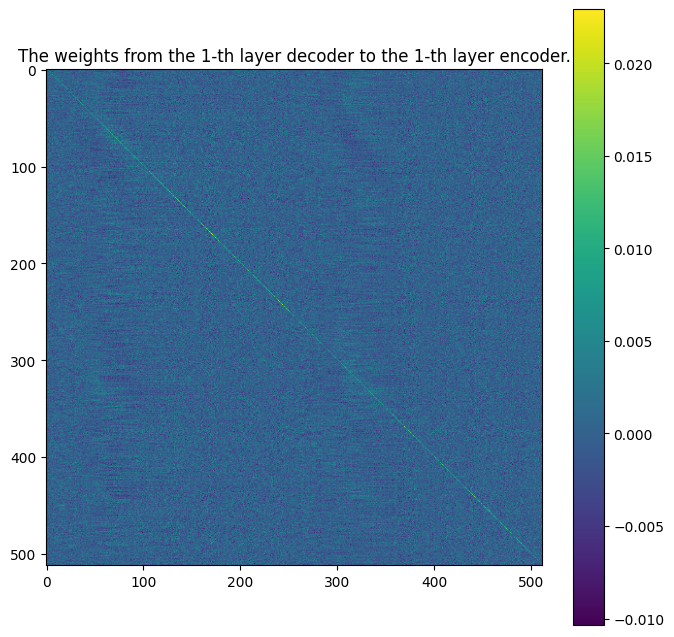

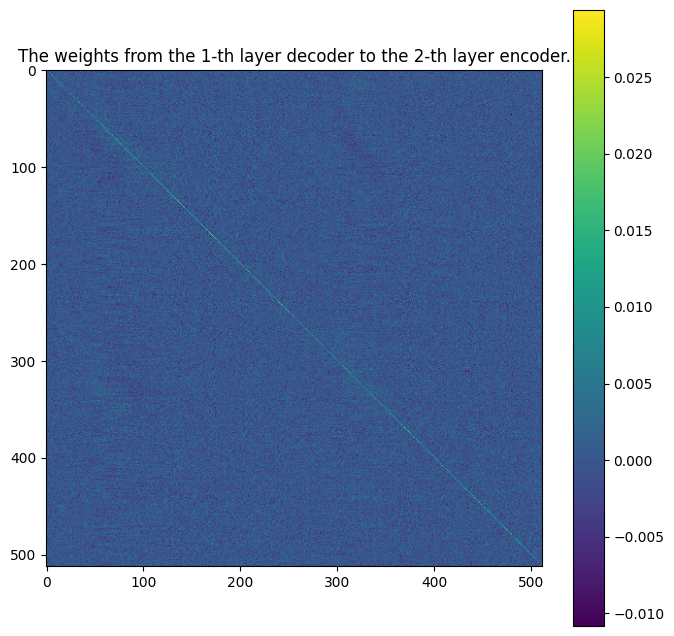

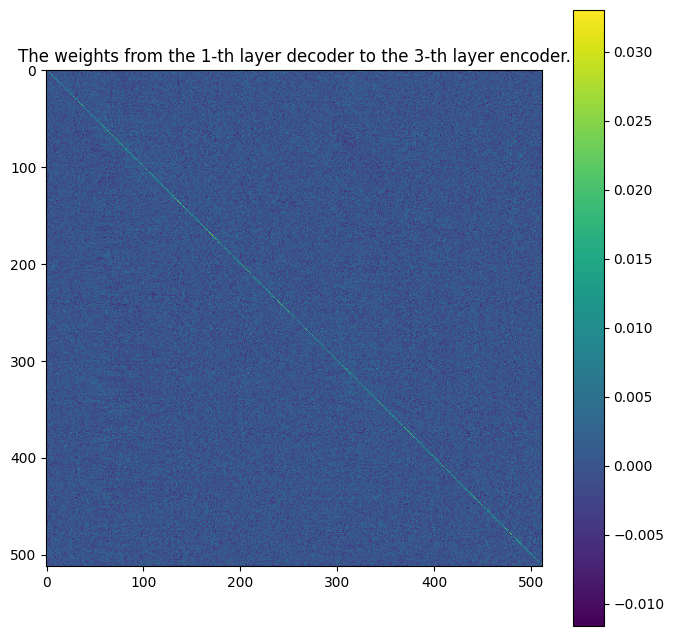

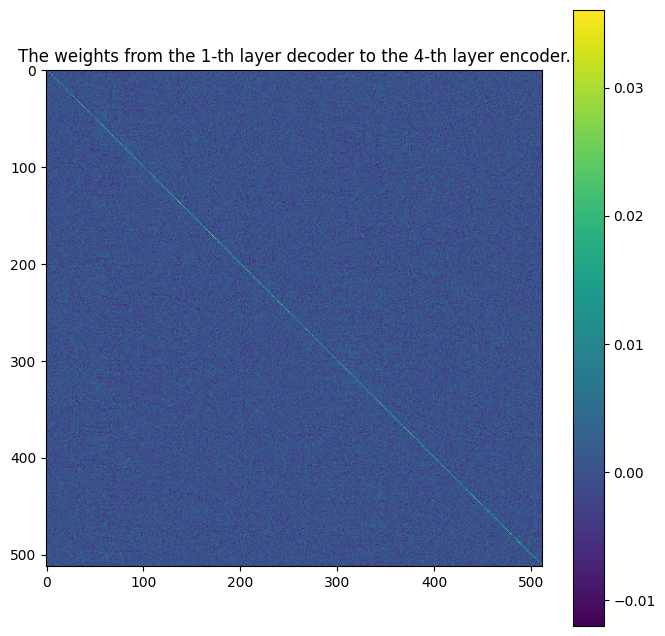

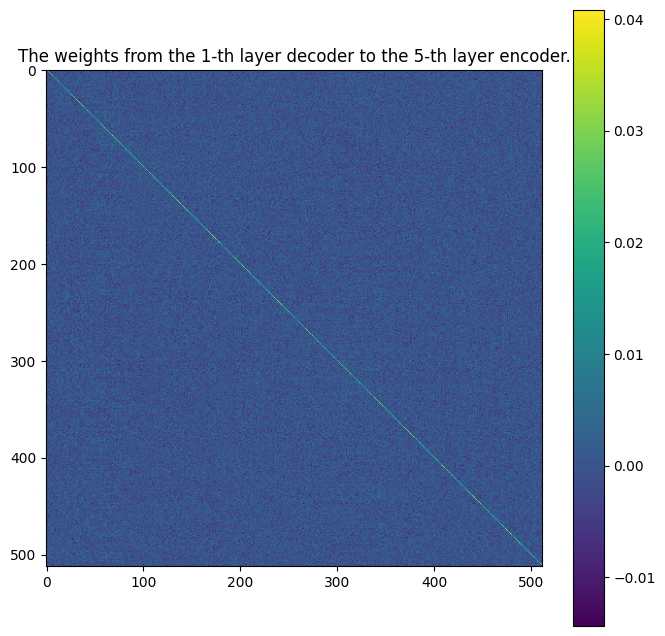

...

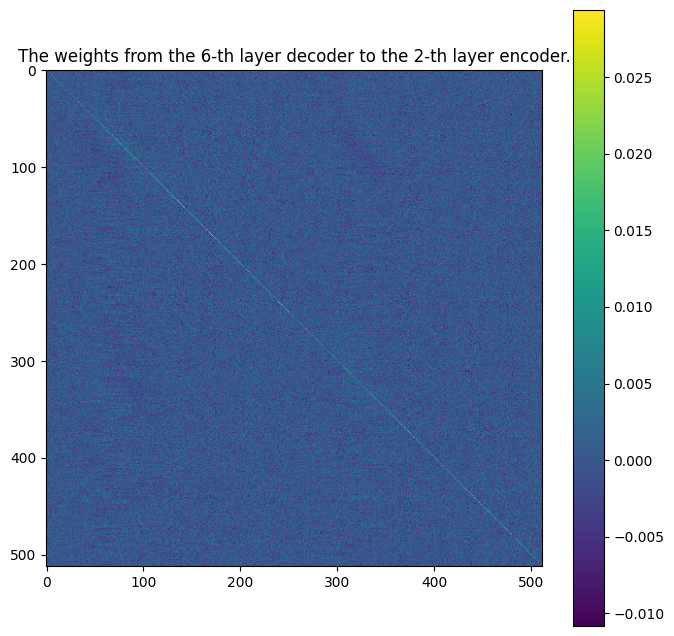

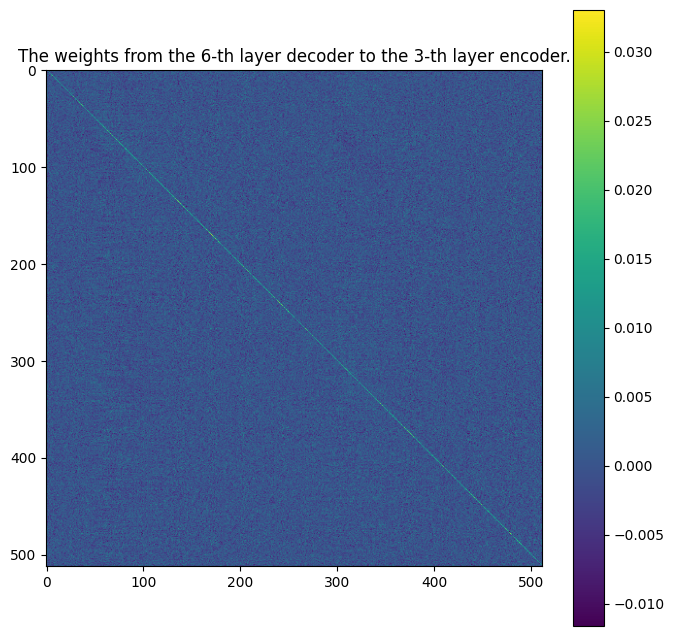

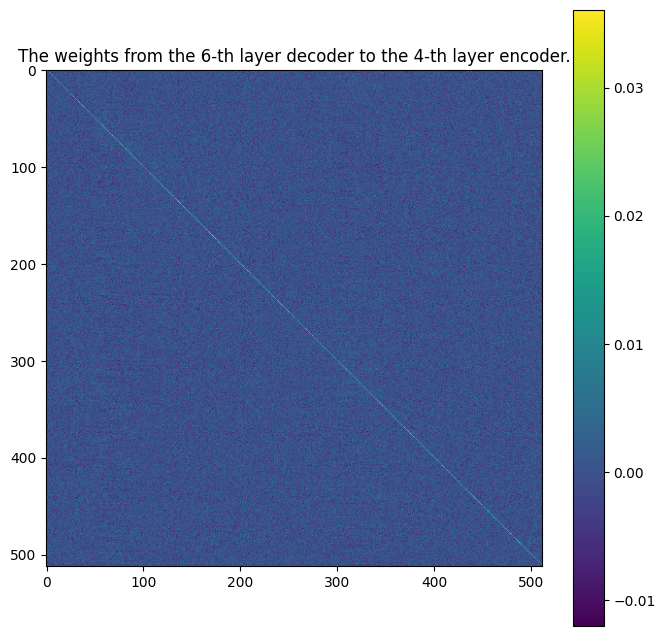

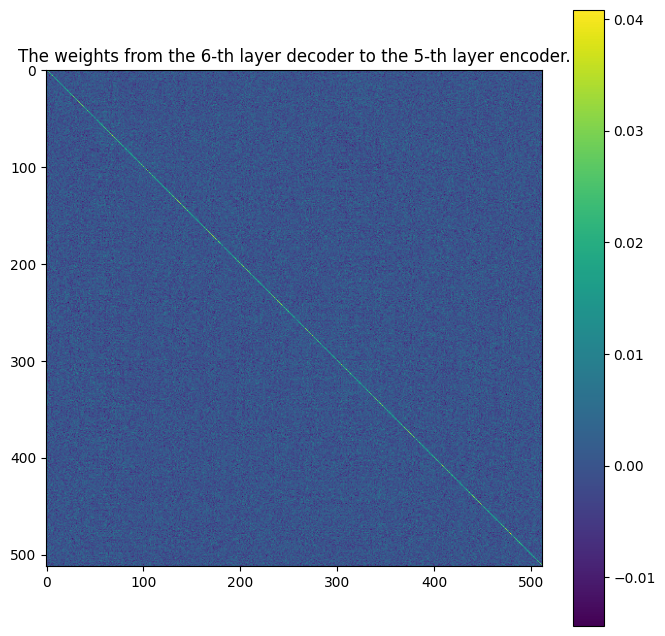

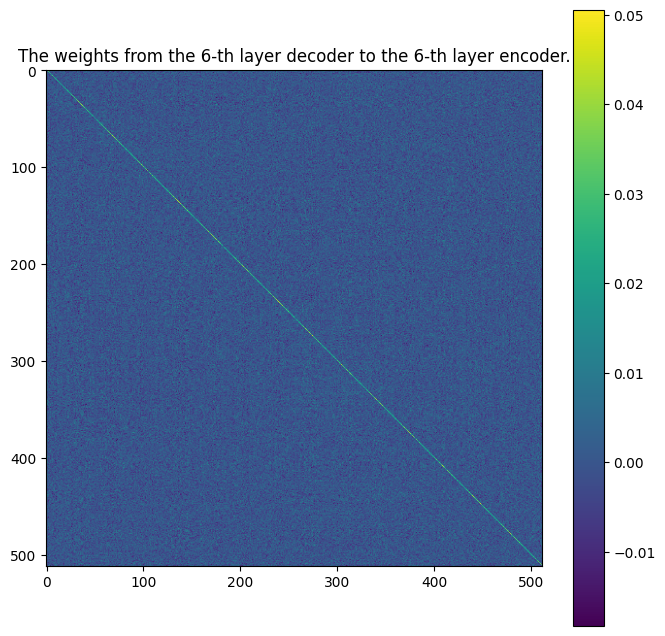

In [45]:
import os
import numpy as np
import matplotlib.pyplot as plt

for i, (name, param) in enumerate(model.decoder.additional_linear_layers.named_parameters()):
    for j in range(6):
        tensor = model.decoder.additional_linear_layers[0].weight[:, 512 * j:512 * (j + 1)].detach().numpy()
        plt.figure(figsize=(8, 8))
        plt.imshow(tensor, cmap='viridis')  # cmap 参数用于选择颜色映射
        plt.colorbar()  # 添加一个颜色条，用于显示值与颜色的对应关系
        title = f'The weights from the {i + 1}-th layer decoder to the {j + 1}-th layer encoder.'
        plt.title(title)  # 添加标题

        # 检查目标文件夹是否存在，不存在则创建它
        folder_path = f'weight/{i + 1}-th decoder'
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        
        plt.savefig(f'weight/{i + 1}-th decoder/{j + 1}-th encoder.png')

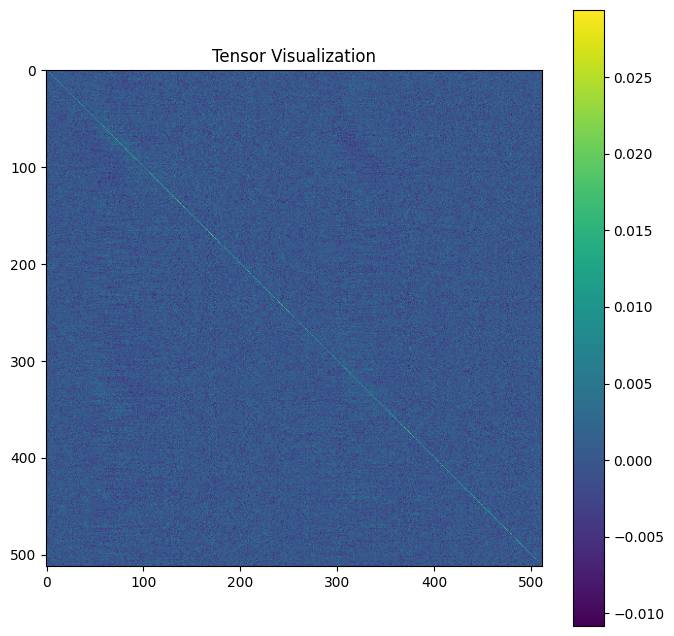

In [37]:


# 假设您有一个名为 tensor 的 512x512 的 numpy 数组
# 这里我用随机生成的数据作为示例
tensor = model.decoder.additional_linear_layers[0].weight[:, 512:1024].detach().numpy()

# 使用 matplotlib 的 imshow 函数绘制图像
plt.figure(figsize=(8, 8))
plt.imshow(tensor, cmap='viridis')  # cmap 参数用于选择颜色映射
plt.colorbar()  # 添加一个颜色条，用于显示值与颜色的对应关系
plt.title("Tensor Visualization")  # 添加标题
# plt.show()

plt.savefig('tensor_visualization.png')